In [1]:

import cv2
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

In [107]:

# Load the image
imageRoot = cv2.imread('data/img/2022-06-01 00:00:00.jpg', cv2.IMREAD_GRAYSCALE)
def plot_image(image):
    #image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    plt.figure(figsize=(50, 50))
    # Display the image using matplotlib
    plt.imshow(image)
    plt.axis('off')  # Turn off axis
    plt.show()



In [147]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# load the image
image = cv2.imread('data/img/2022-06-01 00:00:00.jpg', cv2.IMREAD_COLOR)[740:len(imageRoot[0] -100),940:len(imageRoot[1])-100]

kernel = np.ones((5,5),np.uint8)
#plot_image(image)
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
#plot_image(gray)
closing = cv2.morphologyEx(gray, cv2.MORPH_CLOSE, kernel)
#plot_image(closing)
closing = (closing * -1) + np.max(closing)
#plot_image(closing)
closing[closing < 100] = 0
#plot_image(closing) 

In [151]:
np.unique(thresh)

array([  0, 255], dtype=int16)

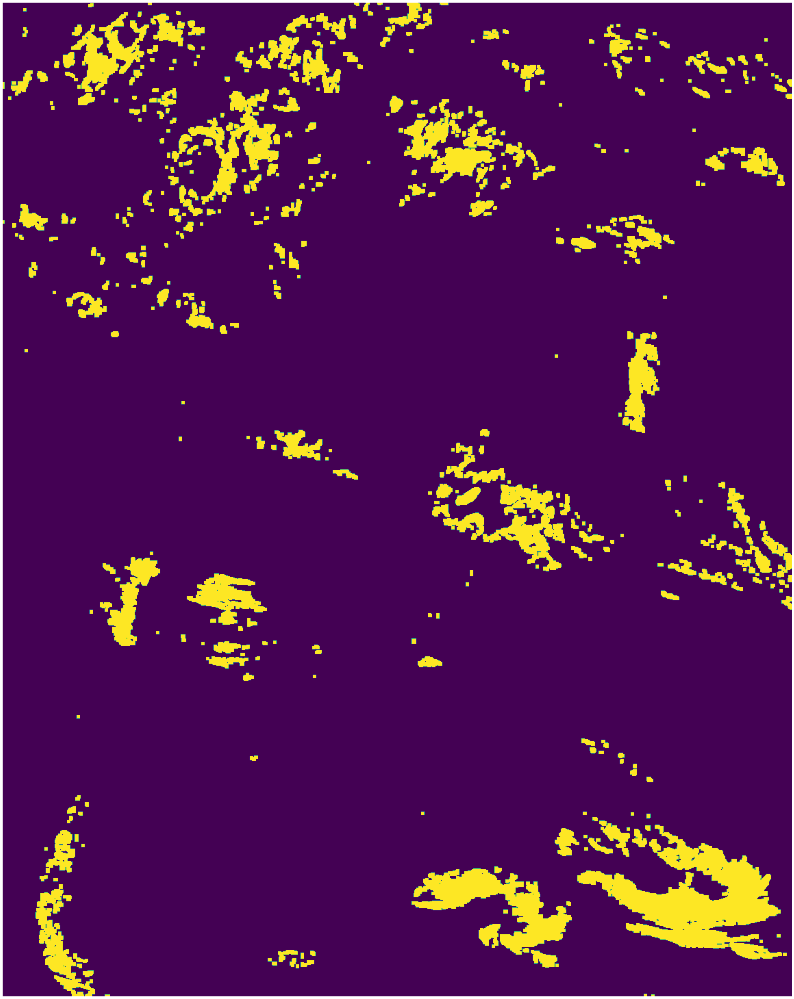

In [148]:
_, thresh = cv2.threshold(closing, 50, 255, cv2.THRESH_BINARY)
plot_image(thresh)

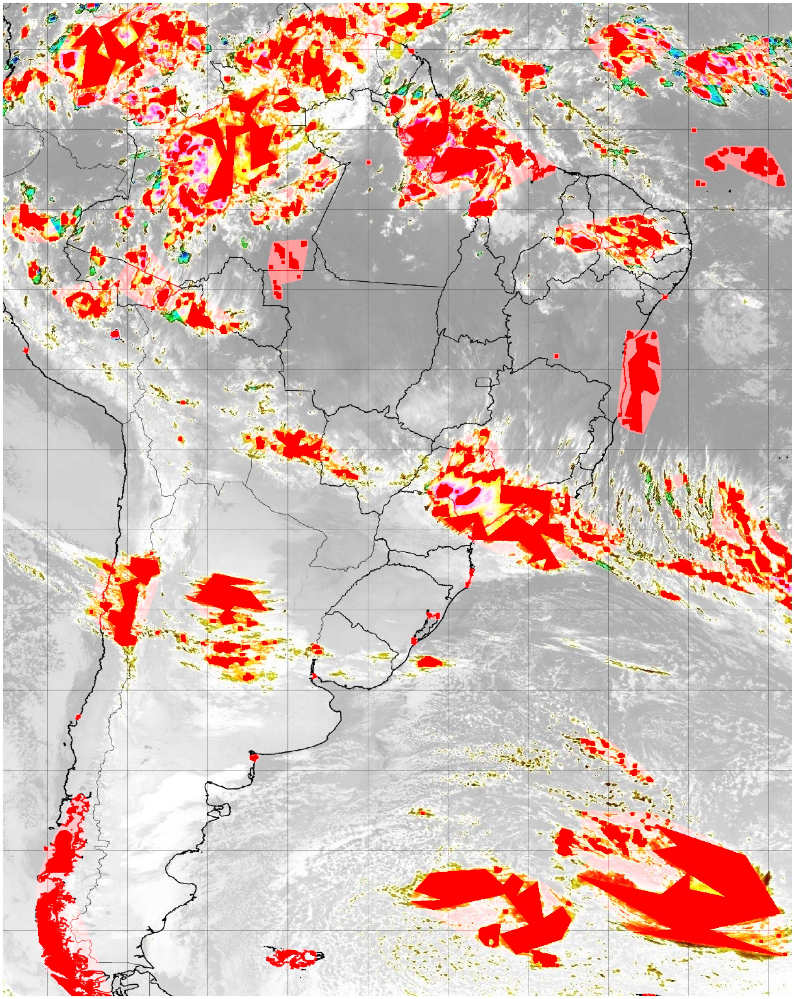

In [170]:

# Sort contours by their area in descending order
thresh = np.array(thresh, np.uint8)
contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

contours = sorted(contours, key=cv2.contourArea, reverse=True)

# Create a blank mask to fill polygons
mask = np.zeros_like(image)

# Define the distance threshold to determine proximity for union
distance_threshold = 20

# Utility function to check proximity between two points
def is_within_distance(point1, point2):
    return np.linalg.norm(point1 - point2) <= distance_threshold

# Function to merge contours representing polygons
def merge_polygons(contour1, contour2):
    merged_contour = np.vstack((contour1, contour2))
    hull = cv2.convexHull(merged_contour)
    return hull
poly_vertices = []
# Iterate through each contour
for i in range(len(contours)):
    # Approximate polygonal curves from the contour
    epsilon = 0.01 * cv2.arcLength(contours[i], True)
    approx = cv2.approxPolyDP(contours[i], epsilon, True)
    
    # Check if contour represents a polygon with at most 4 sides

    # Union adjacent polygons based on proximity
    for j in range(i+1, len(contours)):
        epsilon = 0.01 * cv2.arcLength(contours[j], True)
        approx_j = cv2.approxPolyDP(contours[j], epsilon, True)
        
        # Check proximity and merge polygons
        for point in approx:
            if any(is_within_distance(point[0], p[0]) for p in approx_j):
                approx = merge_polygons(approx, approx_j)
                break
    poly_vertices.append(approx)
    # Draw the merged polygon on the mask
    cv2.fillPoly(mask, [approx], 255)

# Union adjacent polygons by dilating the mask
kernel = np.ones((5, 5), np.uint8)
dilated_mask = cv2.dilate(mask, kernel, iterations=1)

# Apply the unioned mask to the original image
result = cv2.bitwise_or(image, dilated_mask)
plot_image(result)

In [171]:
poly_vertices

[array([[[1144, 1392]],
 
        [[1137, 1392]],
 
        [[ 921, 1358]],
 
        [[ 839, 1275]],
 
        [[ 917, 1183]],
 
        [[ 921, 1183]],
 
        [[ 945, 1185]],
 
        [[1084, 1246]],
 
        [[1135, 1330]],
 
        [[1144, 1388]]], dtype=int32),
 array([[[ 830, 1340]],
 
        [[ 815, 1368]],
 
        [[ 768, 1387]],
 
        [[ 749, 1390]],
 
        [[ 714, 1380]],
 
        [[ 704, 1377]],
 
        [[ 597, 1313]],
 
        [[ 601, 1297]],
 
        [[ 625, 1271]],
 
        [[ 718, 1262]],
 
        [[ 722, 1262]],
 
        [[ 728, 1264]],
 
        [[ 780, 1284]],
 
        [[ 829, 1314]]], dtype=int32),
 array([[[860, 768]],
 
        [[858, 772]],
 
        [[815, 824]],
 
        [[789, 829]],
 
        [[778, 826]],
 
        [[684, 784]],
 
        [[630, 750]],
 
        [[627, 748]],
 
        [[621, 718]],
 
        [[621, 714]],
 
        [[680, 684]],
 
        [[731, 680]],
 
        [[825, 718]],
 
        [[860, 762]]], dtype=int32),
 

In [176]:
output = """[array([[[1144, 1392]],
 
        [[1137, 1392]],
 
        [[ 921, 1358]],
 
        [[ 839, 1275]],
 
        [[ 917, 1183]],
 
        [[ 921, 1183]],
 
        [[ 945, 1185]],
 
        [[1084, 1246]],
 
        [[1135, 1330]],
 
        [[1144, 1388]]], dtype=int32),
 array([[[ 830, 1340]],
 
        [[ 815, 1368]],
 
        [[ 768, 1387]],
 
        [[  0, 322]],
 
        [[  2, 322]],
 
        [[  2, 318]]], dtype=int32)]"""

In [178]:
print(output.split("\n"))

['[array([[[1144, 1392]],', ' ', '        [[1137, 1392]],', ' ', '        [[ 921, 1358]],', ' ', '        [[ 839, 1275]],', ' ', '        [[ 917, 1183]],', ' ', '        [[ 921, 1183]],', ' ', '        [[ 945, 1185]],', ' ', '        [[1084, 1246]],', ' ', '        [[1135, 1330]],', ' ', '        [[1144, 1388]]], dtype=int32),', ' array([[[ 830, 1340]],', ' ', '        [[ 815, 1368]],', ' ', '        [[ 768, 1387]],', ' ', '        [[  0, 322]],', ' ', '        [[  2, 322]],', ' ', '        [[  2, 318]]], dtype=int32)]']


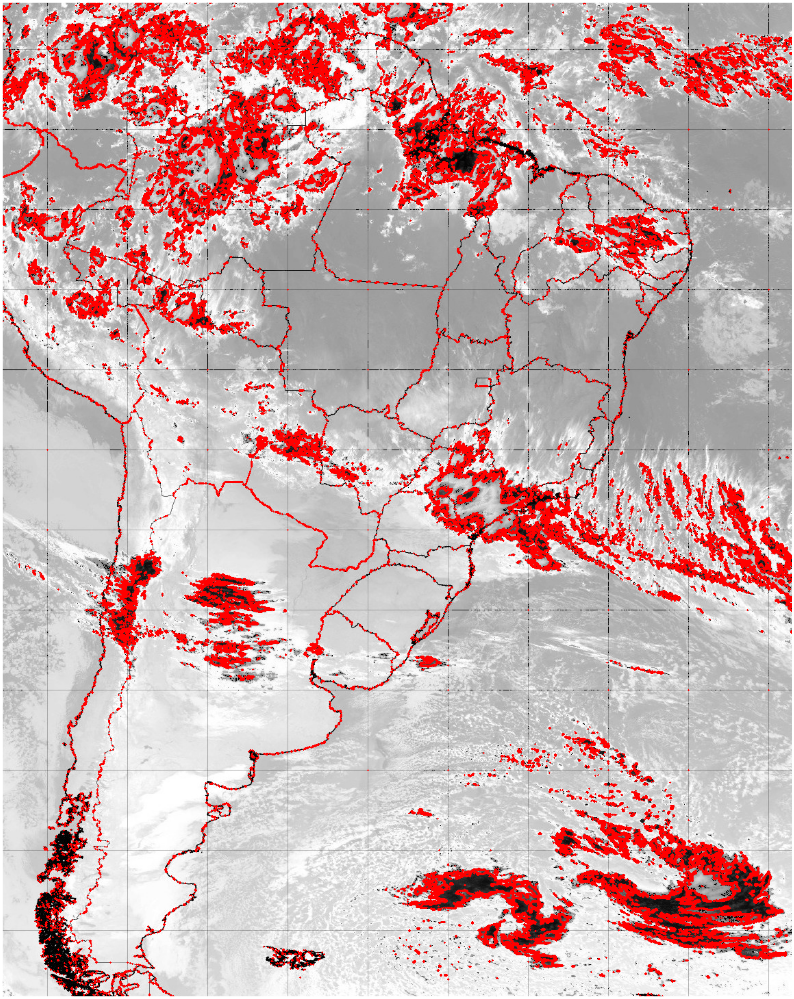

In [60]:
import cv2
import numpy as np

image = imageRoot[740:len(imageRoot[0] -100),940:len(imageRoot[1])-100]
temperatura_minima = -88.0
temperatura_maxima = 100.0

# Primeiro, vamos tentar filtrar as linhas removendo os pixels que correspondem à cor das linhas
# Vamos supor que as linhas tenham uma cor distinta que não seja encontrada nas áreas de tempestade
line_color = 128 # Este é um valor a ser ajustado para corresponder à cor das linhas na imagem
line_tolerance = 1 # Este é um valor a ser ajustado para permitir alguma variação na cor das linhas
mask_lines = cv2.inRange(image, line_color - line_tolerance, line_color + line_tolerance)

# Agora, nós removemos as linhas da imagem colocando esses pixels em 0
image = cv2.bitwise_and(image, image, mask=~mask_lines) 

# Definindo os limites de intensidade para o que consideramos um possível indicativo de tempestade
lower_bound = ((-40.0 - temperatura_minima) / (temperatura_maxima - temperatura_minima)) * 255
upper_bound = ((-10.0 - temperatura_minima) / (temperatura_maxima - temperatura_minima)) * 255

storm_mask = cv2.inRange(image, lower_bound, upper_bound)

# Encontrando os contornos das possíveis áreas de tempestade
contours, _ = cv2.findContours(storm_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Desenhando os contornos das áreas de tempestade na imagem original
image_with_storms = cv2.cvtColor(image, cv2.COLOR_GRAY2BGR)
for contour in contours:
    cv2.drawContours(image_with_storms, [contour], -1, (0, 0, 255), 2)

# Mostrando a imagem com as possíveis áreas de tempestade destacadas
plot_image(image_with_storms)


In [184]:
import os
import subprocess
import pandas as pd
import json
# Cria o arquivo de log
log_file = open('log/log.txt', 'w')

# Cria o dataset Pandas

data_list = []
#dataset = pd.DataFrame(columns=['data','X','Y','poly','vertice'])

# Percorre cada arquivo na pasta 'data/img/'
for file in os.listdir('data/img/'):
    # Obtém o caminho completo do arquivo
    file_path = os.path.join('data/img/', file)
    
    # Chama o script 'utils/decodeImage.py' passando o caminho da imagem como parâmetro
    try:
        output = subprocess.check_output(['python3', 'utils/decodeImage.py', file_path])
        output = json.loads(output)
        
        # Faz o processamento necessário no 'output' para extrair as informações desejadas
        # Supondo que as informações extr
        # Supondo que as informações extraídas estejam no formato mencionado no exemplo
        # Faz o parse do output e extrai as coordenadas e polígonos
        polyCount = 0
        for poly in output:
            verticeCount = 0
            for vertice in poly:
                x = vertice[0][0]
                y = vertice[0][1]
            
            # Adiciona os dados no dataset Pandas
                data_list.append({'data': file,
                                          'X': x, 
                                          'Y': y,
                                          'poly': polyCount,
                                          'vertice': verticeCount})
                verticeCount = verticeCount + 1
            polyCount = polyCount + 1
        # Registra no arquivo de log que não ocorreu erro na execução
        log_file.write(f'{file}: sem erros\n')
    except subprocess.CalledProcessError as err:
        # Registra no arquivo de log que ocorreu um erro na execução
        log_file.write(f'{file}: erro na execução - {err}\n')
    
dataset = pd.DataFrame(data_list)
# Fecha o arquivo de log
log_file.close()

# Exibe o dataset Pandas
print(dataset)
dataset.to_csv('data/imageData.csv', index=False)


Traceback (most recent call last):
  File "/home/bruno/itaLatamChallenge/utils/decodeImage.py", line 16, in <module>
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
cv2.error: OpenCV(4.8.0) /io/opencv/modules/imgproc/src/color.cpp:182: error: (-215:Assertion failed) !_src.empty() in function 'cvtColor'



                            data     X     Y  poly  vertice
0        2022-07-27 14:00:00.jpg   873   280     0        0
1        2022-07-27 14:00:00.jpg   841   720     0        1
2        2022-07-27 14:00:00.jpg   840   721     0        2
3        2022-07-27 14:00:00.jpg   571   771     0        3
4        2022-07-27 14:00:00.jpg   342   765     0        4
...                          ...   ...   ...   ...      ...
6154474  2022-07-22 07:00:00.jpg   773  1448   392        3
6154475  2022-07-22 07:00:00.jpg  1046     0   393        0
6154476  2022-07-22 07:00:00.jpg  1046     2   393        1
6154477  2022-07-22 07:00:00.jpg  1050     2   393        2
6154478  2022-07-22 07:00:00.jpg  1050     0   393        3

[6154479 rows x 5 columns]


In [2]:
dataset = pd.read_csv('data/imageData.csv')

In [3]:
cat62 = pd.read_csv('data/cat-62.csv')

In [10]:
cat62 = cat62[cat62["flightid"] == "62e589aaa96762725b092b898d48a35e"]

In [4]:
cat62["dt_radar"] = pd.to_datetime(cat62["dt_radar"], unit='ms')

In [5]:
cat62.sort_values(by=['dt_radar'], inplace=True)

In [6]:
import math
#apply math degress to lat lon columns
cat62["lat"] = cat62["lat"].apply(math.degrees)
cat62["lon"] = cat62["lon"].apply(math.degrees)

In [7]:
dataset

,data,X,Y,poly,vertice
0,2022-07-27 14:00:00.jpg,873,280,0,0
1,2022-07-27 14:00:00.jpg,841,720,0,1
2,2022-07-27 14:00:00.jpg,840,721,0,2
3,2022-07-27 14:00:00.jpg,571,771,0,3
4,2022-07-27 14:00:00.jpg,342,765,0,4
...,...,...,...,...,...
6154474,2022-07-22 07:00:00.jpg,773,1448,392,3
6154475,2022-07-22 07:00:00.jpg,1046,0,393,0
6154476,2022-07-22 07:00:00.jpg,1046,2,393,1
6154477,2022-07-22 07:00:00.jpg,1050,2,393,2


In [7]:
cat62['dt_radar_2'] = cat62['dt_radar'].dt.round('H')
dataset['data'] = pd.to_datetime(dataset['data'], format='%Y-%m-%d %H:%M:%S.jpg')
dataset['data'] = dataset['data'].dt.round('H')


In [9]:
dataset

,data,X,Y,poly,vertice
0,2022-07-27 14:00:00,873,280,0,0
1,2022-07-27 14:00:00,841,720,0,1
2,2022-07-27 14:00:00,840,721,0,2
3,2022-07-27 14:00:00,571,771,0,3
4,2022-07-27 14:00:00,342,765,0,4
...,...,...,...,...,...
6154474,2022-07-22 07:00:00,773,1448,392,3
6154475,2022-07-22 07:00:00,1046,0,393,0
6154476,2022-07-22 07:00:00,1046,2,393,1
6154477,2022-07-22 07:00:00,1050,2,393,2


In [200]:
bkp = dataset.copy()


In [223]:
dataset = bkp

In [7]:
dataset["X"] = dataset["X"].apply(lambda x: x+925)
dataset["Y"] = dataset["Y"].apply(lambda x: x+725)

In [228]:
dataset

,data,X,Y,poly,vertice
0,2022-07-27 14:00:00.jpg,1798,1005,0,0
1,2022-07-27 14:00:00.jpg,1766,1445,0,1
2,2022-07-27 14:00:00.jpg,1765,1446,0,2
3,2022-07-27 14:00:00.jpg,1496,1496,0,3
4,2022-07-27 14:00:00.jpg,1267,1490,0,4
...,...,...,...,...,...
6154474,2022-07-22 07:00:00.jpg,1698,2173,392,3
6154475,2022-07-22 07:00:00.jpg,1971,725,393,0
6154476,2022-07-22 07:00:00.jpg,1971,727,393,1
6154477,2022-07-22 07:00:00.jpg,1975,727,393,2


In [8]:
def convert_pixel_to_latlong(x, y):
    # set pixel and geographical coordinates for two known points
    pixel_coords = [(71, 22), (2175, 2214)]
    latlon_coords = [(-115, 30), (-25, -55)]

    # calculate ratios
    lat_ratio = (latlon_coords[1][0] - latlon_coords[0][0]) / (pixel_coords[1][0] - pixel_coords[0][0])
    lon_ratio = (latlon_coords[1][1] - latlon_coords[0][1]) / (pixel_coords[1][1] - pixel_coords[0][1])

    # calculate lat and lon for x and y
    latitude = lat_ratio * (x - pixel_coords[0][0]) + latlon_coords[0][0]
    longitude = lon_ratio * (y - pixel_coords[0][1]) + latlon_coords[0][1]
    
    return (longitude,latitude)
convert_pixel_to_latlong(1798, 1005)

(-8.118156934306569, -41.12642585551332)

In [9]:
def convert_latlong_to_pixel(lat, lon):
    # set pixel and geographical coordinates for two known points
    pixel_coords = [(71, 22), (2175, 2214)]
    latlon_coords = [(-115, 30), (-25, -55)]

    # calculate ratios
    lat_ratio = (latlon_coords[1][0] - latlon_coords[0][0]) / (pixel_coords[1][0] - pixel_coords[0][0])
    lon_ratio = (latlon_coords[1][1] - latlon_coords[0][1]) / (pixel_coords[1][1] - pixel_coords[0][1])

    # calculate x and y for lat and lon
    x = (lat - latlon_coords[0][0]) / lat_ratio + pixel_coords[0][0]
    y = (lon - latlon_coords[0][1]) / lon_ratio + pixel_coords[0][1]
    
    return (round(x), round(y))


In [10]:
#cat62["x"] = cat62.apply(lambda x: convert_latlong_to_pixel(x["lat"], x["lon"])[0], axis=1)
#cat62["y"] = cat62.apply(lambda x: convert_latlong_to_pixel(x["lat"], x["lon"])[1], axis=1)

In [11]:
dataset["lat"] = dataset.apply(lambda x: convert_pixel_to_latlong(x["X"], x["Y"])[1], axis=1)
dataset["lon"] = dataset.apply(lambda x: convert_pixel_to_latlong(x["X"], x["Y"])[0], axis=1)

In [12]:
import geopandas as gpd
from shapely.geometry import Point, Polygon

# Create Point geometry for df1
cat62['Coordinates'] = list(zip(cat62.lon, cat62.lat))
cat62['Coordinates'] = cat62['Coordinates'].apply(Point)
gdf1 = gpd.GeoDataFrame(cat62, geometry='Coordinates')

# Create Point geometry for df2
dataset['Coordinates'] = list(zip(dataset.lon, dataset.lat))
dataset['Coordinates'] = dataset['Coordinates'].apply(Point)
gdf2 = gpd.GeoDataFrame(dataset, geometry='Coordinates')


In [13]:
cat62['dt_radar_2'] = cat62['dt_radar_2'].dt.strftime('%Y-%m-%d %H:%M:%S')
dataset['data'] = dataset['data'].dt.strftime('%Y-%m-%d %H:%M:%S')


In [14]:
import dask.dataframe as dd
# Group by 'poly' and 'data' to create polygons with their respective timestamps
polygons_dt = (dataset.groupby(['poly', 'data'])['Coordinates']
                .apply(lambda x: Polygon(x.tolist()))
                .reset_index())

# Create a GeoDataFrame from the polygons and timestamps
gdf_poly_dt = gpd.GeoDataFrame(polygons_dt, geometry='Coordinates')


# Convert pandas dataframes to dask dataframes
df1 = dd.from_pandas(cat62, npartitions=10) 
gdf_poly_dt = dd.from_pandas(gdf_poly_dt, npartitions=10)

df1['in_polygon'] = dd.map_partitions(lambda df: df.apply(lambda x: any(x['Coordinates'].within(poly) for poly in 
                                            gdf_poly_dt.loc[gdf_poly_dt['data'] == x['dt_radar'], 'Coordinates'].values),
                                            axis=1), meta='int').compute(scheduler='processes')

# Convert dask dataframe back to pandas dataframe
#


TypeError: <lambda>() missing 1 required positional argument: 'df'

Traceback
---------
  File "/home/bruno/.local/lib/python3.10/site-packages/dask/local.py", line 225, in execute_task
    result = _execute_task(task, data)
  File "/home/bruno/.local/lib/python3.10/site-packages/dask/core.py", line 127, in _execute_task
    return func(*(_execute_task(a, cache) for a in args))
  File "/home/bruno/.local/lib/python3.10/site-packages/dask/utils.py", line 75, in apply
    return func(*args)


In [15]:
def within_polygons(df, gdf_poly_dt=gdf_poly_dt.compute()):
    df['in_polygon'] = df.apply(lambda x: any(x['Coordinates'].within(poly) for poly in 
                                             gdf_poly_dt.loc[gdf_poly_dt['data'] == x['dt_radar'], 'Coordinates'].values),
                                             axis=1)
    return df

df1 = df1.map_partitions(within_polygons, meta=df1)


In [17]:
df1 = df1.compute()

In [ ]:
#df1.to_csv('data/cat62-dataimageohg

In [15]:

# Next we'll do a left join of df1 onto Poly, merging on the date-time
result = pd.merge(cat62, gdf_poly_dt,  how='left', left_on=['dt_radar_2'], right_on = ['data'])

# Create a binary column indicating whether flight is within a polygon and matching the timestamps
result['in_polygon'] = result.apply(lambda x: 1 if x['Coordinates_x'].within(x['Coordinates_y']) else 0, axis=1)


In [ ]:
result

In [ ]:
# Group by 'poly' and create a polygon out of all points in the group
polygons = gdf2.groupby('poly')['Coordinates'].apply(lambda x: Polygon(x.tolist())).reset_index()

# Create a GeoDataFrame from the polygons
gdf_poly = gpd.GeoDataFrame(polygons, geometry='Coordinates')


In [ ]:
# Perform spatial join
result = gpd.sjoin(gdf1, gdf_poly, op='within')

# Create a binary column indicating whether flight is within a polygon
cat62['in_polygon'] = cat62.index.isin(result.index).astype(int)


/home/bruno/.local/lib/python3.10/site-packages/IPython/core/interactiveshell.py:3466: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):


In [ ]:
cat62.to_csv("cat62_with_polygon.csv", index=False)

,flightid,lat,lon,flightlevel,speed,dt_radar,Coordinates,in_polygon
163,62e589aaa96762725b092b898d48a35e,-29.993066,-51.106053,17.0,157.0,2022-06-01 02:34:02,POINT (-51.10605334671248 -29.993065503362153),1
7,62e589aaa96762725b092b898d48a35e,-29.993830,-51.051899,33.0,164.0,2022-06-01 02:35:02,POINT (-51.05189891717318 -29.993830419207388),1
63,62e589aaa96762725b092b898d48a35e,-29.947744,-51.035229,47.0,181.0,2022-06-01 02:36:02,POINT (-51.03522944923942 -29.94774407767149),1
53,62e589aaa96762725b092b898d48a35e,-29.902966,-51.008010,63.0,181.0,2022-06-01 02:37:03,POINT (-51.008010499035194 -29.90296560397623),1
41,62e589aaa96762725b092b898d48a35e,-29.855489,-50.981703,73.0,183.0,2022-06-01 02:38:03,POINT (-50.98170340543235 -29.85548943298711),1
...,...,...,...,...,...,...,...,...
199,62e589aaa96762725b092b898d48a35e,-23.451632,-46.554328,37.0,113.0,2022-06-01 04:32:06,POINT (-46.55432844384824 -23.451632024862768),0
201,62e589aaa96762725b092b898d48a35e,-23.444060,-46.527553,32.0,102.0,2022-06-01 04:33:04,POINT (-46.527553472909894 -23.444059671402872),0
202,62e589aaa96762725b092b898d48a35e,-23.443554,-46.525392,32.0,102.0,2022-06-01 04:33:06,POINT (-46.52539166304182 -23.44355428252052),0
77,62e589aaa96762725b092b898d48a35e,-23.435267,-46.496219,25.0,107.0,2022-06-01 04:34:02,POINT (-46.496219241883 -23.435266522498466),0
